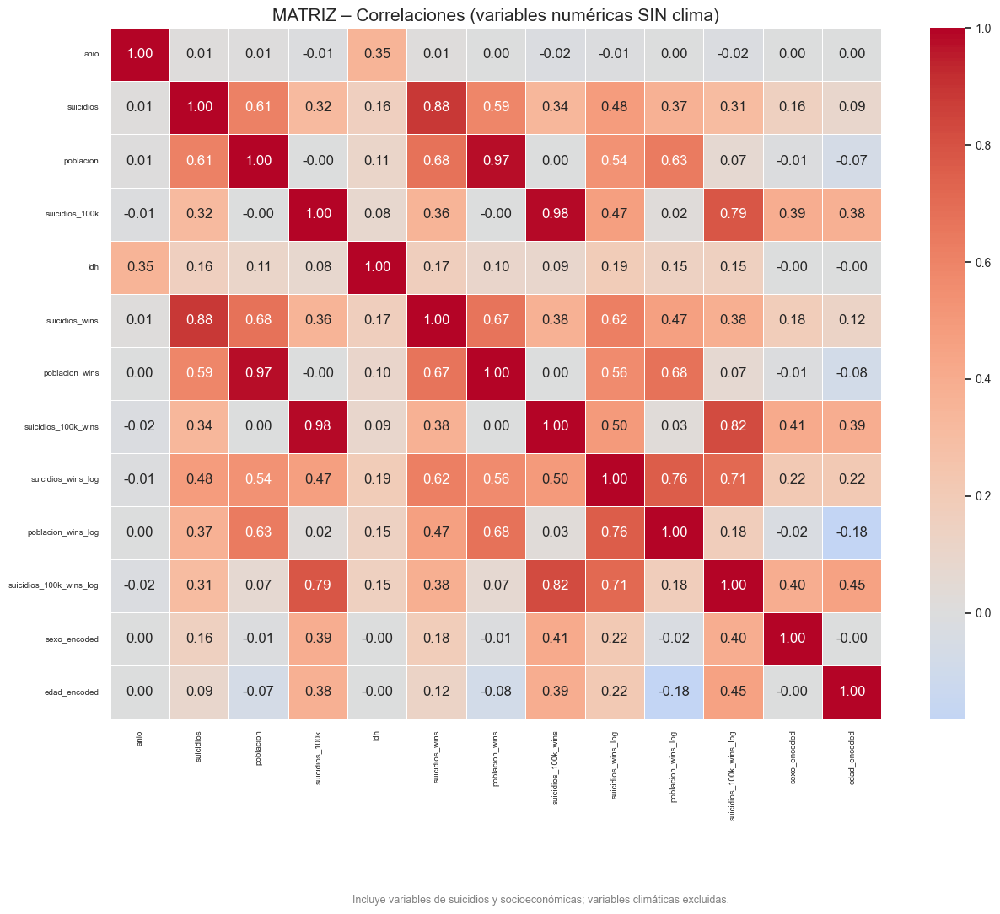

C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:290: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:290: UserWarning:


The palette list has fewer values (8) than needed (15) and will cycle, which may produce an uninterpretable plot.



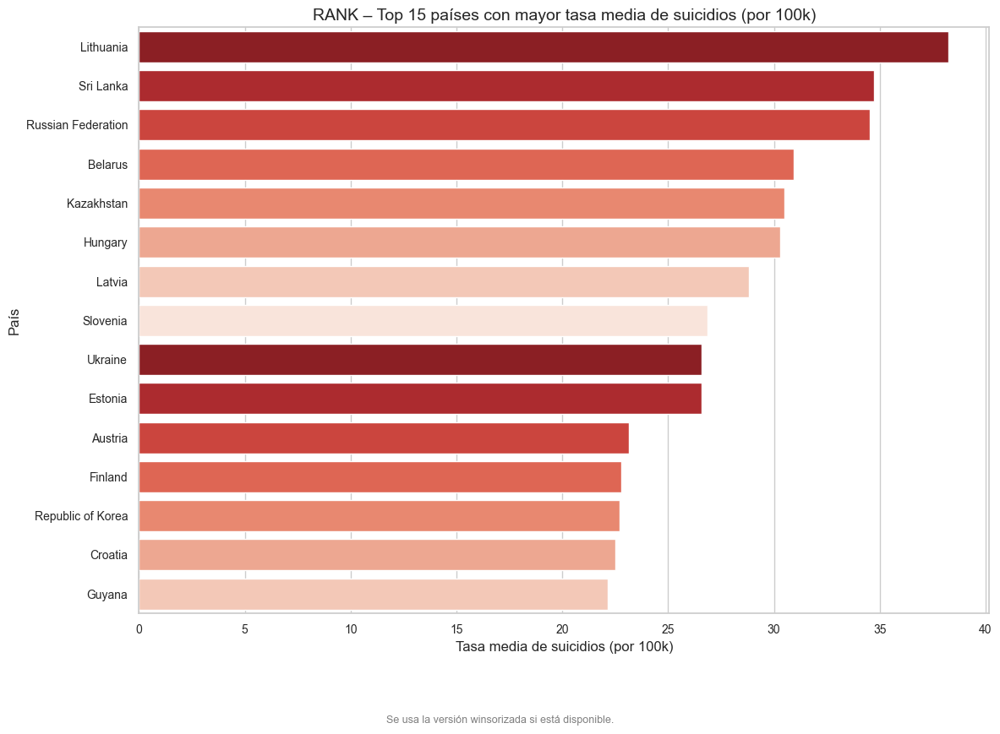

C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:318: UserWarning:

The palette list has more values (8) than needed (2), which may not be intended.



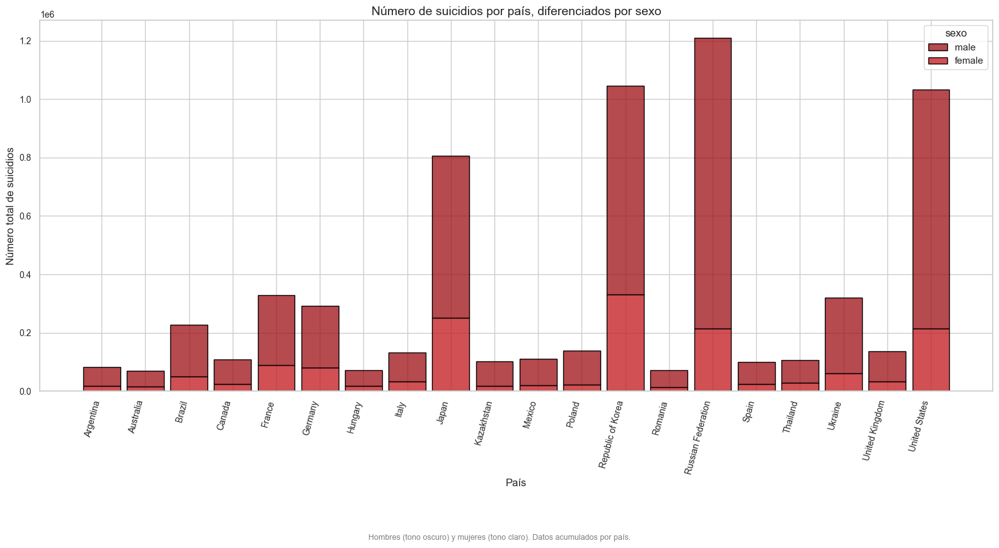

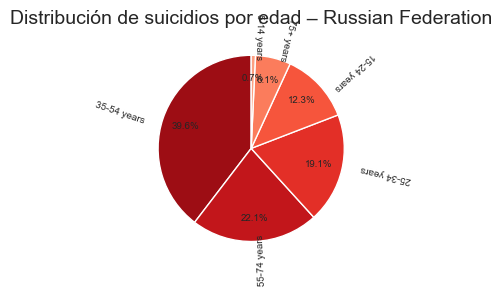

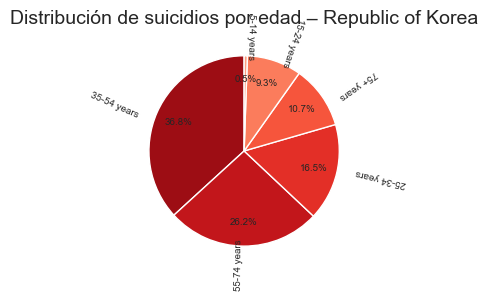

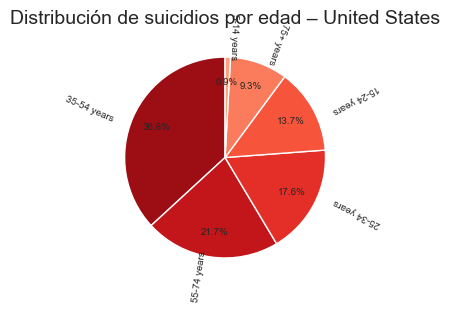

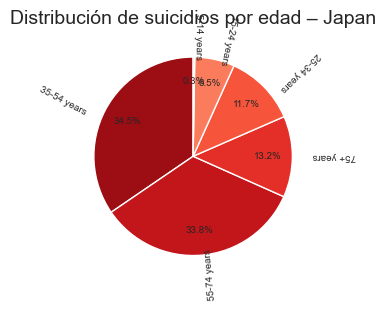

...

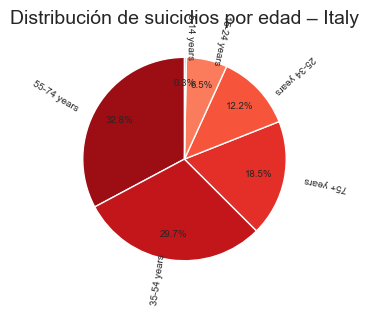

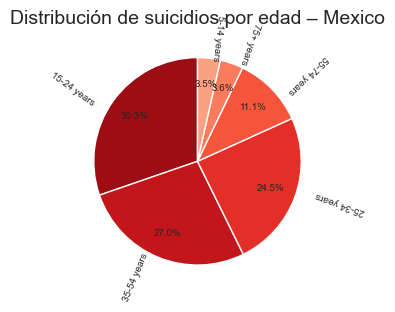

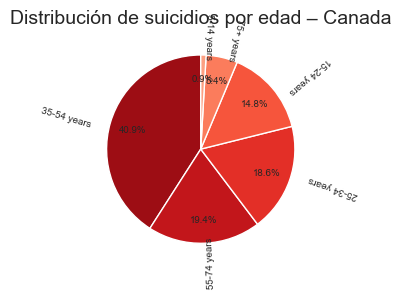

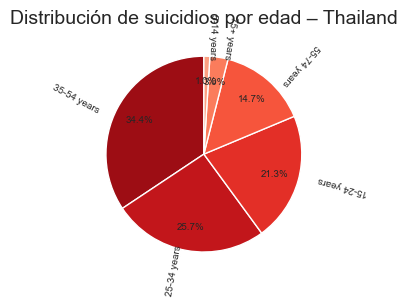

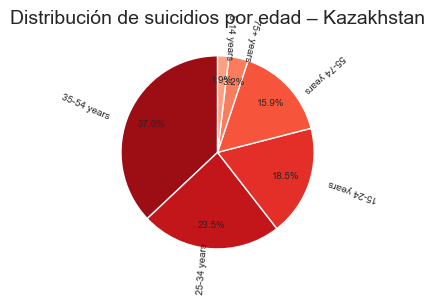

C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:425: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:428: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


C:\Users\Alex\AppData\Local\Temp\ipykernel_2804\2042879820.py:428: UserWarning:

The palette list has more values (8) than needed (4), which may not be intended.



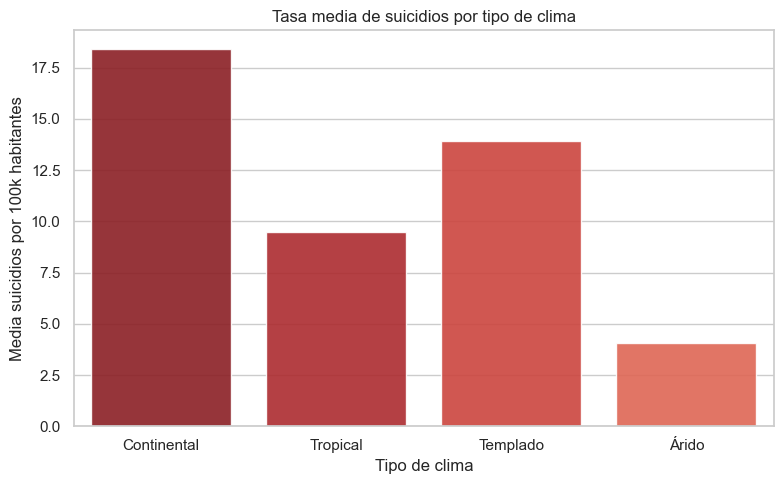

In [ ]:
from importaciones import *
from funcionesEDA import *


# ============================================================
# CONFIGURACIÓN
# ============================================================
SUICIDE_CSV = "data/master_final.csv"       
OUTPUT_CSV  = "data/master_final.csv"  
CORR_CSV    = "data/final_correlation_matrix.csv"
MAP_HTML    = "data/mapa_animado.html"
RACE_HTML   = "data/race_chart.html"

# ============================================================
# APARIENCIA GLOBAL DE GRÁFICOS
# ============================================================
sns.set_theme(style="whitegrid")
palette_base = sns.color_palette("Reds_r", 8)
sns.set_palette(palette_base)
plt.rcParams.update({
    "figure.dpi": 100,
    "axes.titlesize": 14,
    "axes.labelsize": 12,
    "xtick.labelsize": 10,
    "ytick.labelsize": 10
})

def add_caption(text, y_offset=-0.08):
    plt.figtext(0.5, y_offset, text, ha="center", fontsize=9, color="gray")

def get_country_col(df):
    """
    Devuelve la mejor columna disponible para país.
    """
    for c in ["pais", "pais_limpio", "country_clean", "country_std", "country_prueba", "country"]:
        if c in df.columns:
            return c
    return None

# ============================================================
# 0) CARGA Y LIMPIEZA DEL CSV ORIGINAL
# ============================================================
df = pd.read_csv(SUICIDE_CSV)

# Normalizar nombres de columnas
df.columns = (
    df.columns
      .str.strip()
      .str.lower()
      .str.replace(" ", "_")
      .str.replace(r"[()$]", "", regex=True)
      .str.replace("/", "_")
)

# Renombrar a nombres claros en español
df = df.rename(columns={
    "country": "pais",
    "year": "anio",
    "sex": "sexo",
    "age": "edad",
    "suicides_no": "suicidios",
    "population": "poblacion",
    "suicides_100k_pop": "suicidios_100k",
    "suicides/100k_pop": "suicidios_100k",
    "hdi_for_year": "idh",
    "gdp_for_year_$": "pib_anual_usd",
    "gdp_for_year": "pib_anual_usd",
    "gdp_per_capita_$": "pib_per_capita_usd",
    "gdp_per_capita": "pib_per_capita_usd",
    "country_clean": "pais_limpio"
})

# Quitar posibles columnas duplicadas
df = df.loc[:, ~df.columns.duplicated()]

# Eliminar columnas auxiliares que no aportan
df = df.drop(columns=["country-year", "country_year"], errors="ignore")

# Filtro de años
if "anio" in df.columns:
    df["anio"] = pd.to_numeric(df["anio"], errors="coerce")
    df = df[(df["anio"] >= 1985) & (df["anio"] <= 2015)]

# Limpieza de formato de PIB anual (si existe)
if "pib_anual_usd" in df.columns:
    df["pib_anual_usd"] = df["pib_anual_usd"].astype(str).str.replace(",", "", regex=False)
    df["pib_anual_usd"] = pd.to_numeric(df["pib_anual_usd"], errors="coerce")

# Tipificar numéricas principales
numeric_cols = [
    "anio", "suicidios", "poblacion", "suicidios_100k",
    "idh", "pib_anual_usd", "pib_per_capita_usd"
]
for c in numeric_cols:
    if c in df.columns:
        df[c] = pd.to_numeric(df[c], errors="coerce")

# Crear tasa suicidios_100k si falta
if "suicidios_100k" not in df.columns and {"suicidios", "poblacion"}.issubset(df.columns):
    df["suicidios_100k"] = (df["suicidios"] / df["poblacion"].replace({0: np.nan})) * 100000

# Selección de columnas relevantes (incluyendo clima macro y clima numérico)
cols_keep = []
for col in [
    "pais", "pais_limpio", "anio", "sexo", "edad",
    "suicidios", "poblacion", "suicidios_100k",
    "idh", "pib_anual_usd", "pib_per_capita_usd",
    "region", "climate", "climate_merged",
    "temperature_celsius", "humidity", "cloud", "uv_index",
    "air_quality_pm2.5", "air_quality_pm10",
    "air_quality_ozone", "air_quality_carbon_monoxide",
    "air_quality_nitrogen_dioxide", "air_quality_sulphur_dioxide"
]:
    if col in df.columns:
        cols_keep.append(col)

df = df[cols_keep]

# ============================================================
# 1) WINSORIZACIÓN
# ============================================================
def winsorize(series, lower=0.01, upper=0.99):
    ql = series.quantile(lower)
    qh = series.quantile(upper)
    return series.clip(ql, qh)

winsorize_targets = [
    c for c in ["suicidios", "poblacion", "pib_anual_usd",
                "pib_per_capita_usd", "suicidios_100k"]
    if c in df.columns
]

for c in winsorize_targets:
    if df[c].notnull().any():
        df[c + "_wins"] = winsorize(df[c])
    else:
        df[c + "_wins"] = df[c]

# ============================================================
# 2) TRANSFORMACIONES LOG
# ============================================================
for base in [c for c in df.columns if c.endswith("_wins")]:
    try:
        df[base + "_log"] = np.log1p(df[base])
    except Exception:
        df[base + "_log"] = np.nan

# ============================================================
# 3) ENCODING CATEGÓRICO
# ============================================================
if "sexo" in df.columns:
    df["sexo_encoded"] = df["sexo"].map({"male": 1, "female": 0})

age_map = {
    "5-14_years": 1, "15-24_years": 2, "25-34_years": 3,
    "35-54_years": 4, "55-74_years": 5, "75+_years": 6,
    "5-14 years": 1, "15-24 years": 2, "25-34 years": 3,
    "35-54 years": 4, "55-74 years": 5, "75+ years": 6
}
if "edad" in df.columns:
    df["edad_encoded"] = df["edad"].map(age_map)

# ============================================================
# 4) GUARDAR CSV LIMPIO
# ============================================================
df.to_csv(OUTPUT_CSV, index=False)

# ============================================================
# 5) MATRIZ DE CORRELACIÓN (SIN VARIABLES CLIMÁTICAS)
# ============================================================
df_corr = df.select_dtypes(include=[np.number]).copy()

CLIMATE_PATTERNS = ["climate", "temp", "humidity", "air_quality", "uv", "rain", "snow"]

cols_to_drop_from_corr = [
    c for c in df_corr.columns
    if any(pat in c.lower() for pat in CLIMATE_PATTERNS)
]

df_corr = df_corr.drop(columns=cols_to_drop_from_corr, errors="ignore")

corr = df_corr.corr()
corr.to_csv(CORR_CSV, index=False)

plt.figure(figsize=(13, 10))
plt.xticks(fontsize=7, rotation=90)
plt.yticks(fontsize=7)
sns.heatmap(
    corr,
    cmap="coolwarm",
    annot=True,
    fmt=".2f",
    linewidths=.4,
    center=0
)
plt.title("MATRIZ – Correlaciones (variables numéricas SIN clima)", fontsize=15)
add_caption("Incluye variables de suicidios y socioeconómicas; variables climáticas excluidas.")
plt.tight_layout()
plt.show()

# ============================================================
# 6) MAPAS ANIMADOS Y RACE CHART
# ============================================================
geo_url = "https://raw.githubusercontent.com/johan/world.geo.json/master/countries.geo.json"
try:
    geojson = requests.get(geo_url).json()
except Exception:
    geojson = None

if "suicidios_100k_wins" in df.columns:
    tasa_col = "suicidios_100k_wins"
elif "suicidios_100k" in df.columns:
    tasa_col = "suicidios_100k"
else:
    tasa_col = None

country_col = get_country_col(df)

if tasa_col is not None and country_col is not None and "anio" in df.columns and geojson is not None:

    mapa_anim = (
        df.groupby([country_col, "anio"], as_index=False)
          .agg(suicidios_prom_100k=(tasa_col, "mean"))
          .rename(columns={country_col: "country"})
    )

    fig_map = px.choropleth(
        mapa_anim,
        locations="country",
        geojson=geojson,
        featureidkey="properties.name",
        color="suicidios_prom_100k",
        animation_frame="anio",
        range_color=(0, mapa_anim["suicidios_prom_100k"].max()),
        color_continuous_scale="Reds",
        title="MAPA – Evolución anual de la tasa de suicidios por 100k (1985–2015)"
    )
    fig_map.update_geos(showcountries=True, showcoastlines=True, projection_type="natural earth")
    fig_map.update_layout(margin=dict(r=0, t=40, l=0, b=0))

    try:
        fig_map.show()
    except Exception:
        fig_map.write_html(MAP_HTML)

    rank_anim = (
        mapa_anim.sort_values(["anio", "suicidios_prom_100k"], ascending=[True, False])
                 .groupby("anio")
                 .head(15)
    )

    fig_race = px.bar(
        rank_anim,
        x="suicidios_prom_100k",
        y="country",
        orientation="h",
        color="country",
        animation_frame="anio",
        range_x=[0, mapa_anim["suicidios_prom_100k"].max()],
        title="RACE – TOP 15 países por tasa de suicidios (1985–2015)"
    )
    fig_race.update_yaxes(autorange="reversed")

    try:
        fig_race.show()
    except Exception:
        fig_race.write_html(RACE_HTML)

# ============================================================
# 7) TOP 15 PAÍSES POR TASA MEDIA DE SUICIDIOS
# ============================================================
if "suicidios_100k_wins" in df.columns:
    target_col_top = "suicidios_100k_wins"
elif "suicidios_100k" in df.columns:
    target_col_top = "suicidios_100k"
else:
    target_col_top = None

if target_col_top is not None:
    country_col = get_country_col(df)
    if country_col is not None:
        top15 = (
            df.groupby(country_col)[target_col_top]
              .mean()
              .sort_values(ascending=False)
              .head(15)
        )

        plt.figure(figsize=(12, 8))
        sns.barplot(x=top15.values, y=top15.index, palette=palette_base)
        plt.title("RANK – Top 15 países con mayor tasa media de suicidios (por 100k)", fontsize=14)
        plt.xlabel("Tasa media de suicidios (por 100k)")
        plt.ylabel("País")
        add_caption("Se usa la versión winsorizada si está disponible.")
        plt.tight_layout()
        plt.show()

# ============================================================
# 8) SUICIDIOS POR PAÍS DIFERENCIADOS POR SEXO
# ============================================================
country_col = get_country_col(df)

if country_col is not None:
    suicidios_col_for_plot = "suicidios" if "suicidios" in df.columns else None

    if suicidios_col_for_plot is not None:
        top_countries = (
            df.groupby(country_col)[suicidios_col_for_plot]
              .sum()
              .sort_values(ascending=False)
              .head(20)
              .index
        )

        df_plot = df[df[country_col].isin(top_countries)]

        plt.figure(figsize=(16, 8))
        sns.histplot(
            data=df_plot,
            x=country_col,
            hue="sexo" if "sexo" in df_plot.columns else None,
            weights=suicidios_col_for_plot,
            multiple="stack",
            palette=palette_base,
            shrink=0.85,
            edgecolor="black"
        )

        plt.xticks(rotation=75, ha="right")
        plt.title("Número de suicidios por país, diferenciados por sexo", fontsize=14)
        plt.ylabel("Número total de suicidios")
        plt.xlabel("País")
        add_caption("Hombres (tono oscuro) y mujeres (tono claro). Datos acumulados por país.")
        plt.tight_layout()
        plt.show()

# ============================================================
# 9) DONUTS – DISTRIBUCIÓN POR EDAD EN TOP 15 PAÍSES
# ============================================================
country_col = get_country_col(df)

top15_paises = (
    df.groupby(country_col)["suicidios"]
        .sum()
        .sort_values(ascending=False)
        .head(15)
        .index
)

df_top15 = df[df[country_col].isin(top15_paises)]

for pais in top15_paises:
    sub = (
        df_top15[df_top15[country_col] == pais]
        .groupby("edad")["suicidios"]
        .sum()
        .sort_values(ascending=False)
    )

    sub = sub[sub > 0]

    plt.figure(figsize=(3.5, 3.5))

    wedges, texts, autotexts = plt.pie(
        sub.values,
        labels=sub.index,
        autopct="%1.1f%%",
        startangle=90,
        textprops={'fontsize': 7},
        pctdistance=0.75,
        labeldistance=1.1
    )

    plt.title(f"Distribución de suicidios por edad – {pais}")

    for t, w in zip(texts, wedges):
        ang = (w.theta2 + w.theta1) / 2
        x = np.cos(np.deg2rad(ang))
        y = np.sin(np.deg2rad(ang))
        t.set_position((1.2 * x, 1.2 * y))
        rotation = ang
        if ang < -90 or ang > 90:
            rotation = ang + 180
        t.set_rotation(rotation)

    plt.tight_layout()
    plt.show()

#---------------------------------------------------------------------------------------------------------------------


# --------------------------------------------------------------
# 0) Ajustes visuales
# --------------------------------------------------------------
sns.set_theme(style="whitegrid")
palette_base = sns.color_palette("Reds_r", 8)
reds = sns.color_palette("Reds_r", 10)

# --------------------------------------------------------------
# 0) Ajustes visuales
# --------------------------------------------------------------
sns.set_theme(style="whitegrid")
palette_base = sns.color_palette("Reds_r", 8)
reds = sns.color_palette("Reds_r", 10)



# --------------------------------------------------------------
# 1) Gráfico categórico: clima agrupado vs suicidios
# --------------------------------------------------------------
CLIMATE_LABELS = {
    "A": "Tropical",
    "B": "Árido",
    "C": "Templado",
    "D": "Continental"
}

if "climate_merged" in df.columns:

    df_cat = df.dropna(subset=["climate_merged", tasa_col])

    df_cat["clima_nombre"] = df_cat["climate_merged"].map(CLIMATE_LABELS)

    plt.figure(figsize=(8,5))
    sns.barplot(
        data=df_cat,
        x="clima_nombre",
        y=tasa_col,
        palette=palette_base,
        estimator="mean",
        errorbar=None,
        alpha=0.9
    )

    plt.title("Tasa media de suicidios por tipo de clima")
    plt.xlabel("Tipo de clima")
    plt.ylabel("Media suicidios por 100k habitantes")
    plt.xticks(rotation=0)
    plt.tight_layout()
    plt.show()
